In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import seaborn as sns
import tensorflow as tf
import larq as lq
import matplotlib.pyplot as plt
from tensorflow import keras
from keras.models import Sequential
from larq.layers import QuantDense
from larq import layers
from keras_tuner.tuners import RandomSearch
from collections import Counter
from imblearn.over_sampling import SMOTE
from sklearn.utils import class_weight

2024-06-27 10:02:04.023625: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-06-27 10:02:04.424616: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-06-27 10:02:04.427616: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-06-27 10:02:05.606008: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


### DATA CLEANING AND PREPROCESSING

In [2]:
# Load the dataset
df = pd.read_csv('german_credit_rules_full_single.csv')
df.head()

,age_high,age_low,credit_duration_months_high,credit_duration_months_low,installment_rate(perc_disp_income)_high,installment_rate(perc_disp_income)_low,credit_amount_high,credit_amount_low,residence_duration_high,residence_duration_low,...,guarantor_none__AND__credit_duration_months_high,foreign_worker_yes__AND__previous_credit_payment_status_existing_credits_paid_till_now,occupation_skilled-employee__AND__foreign_worker_yes,occupation_skilled-employee__AND__guarantor_none,occupation_skilled-employee__AND__other_credits_none,foreign_worker_yes__AND__telephone_no,guarantor_none__AND__telephone_no,foreign_worker_yes__AND__residence_duration_high,residence_duration_high__AND__guarantor_none,credit_rating
0,0,1,1,0,1,0,1,0,0,1,...,1,1,0,0,0,0,0,0,0,0
1,0,1,1,0,1,0,0,1,1,0,...,1,1,1,1,0,1,1,1,1,0
2,1,0,1,0,1,0,0,1,1,0,...,1,1,1,1,1,0,0,1,1,1
3,0,1,1,0,1,0,1,0,1,0,...,1,1,1,1,1,1,1,1,1,1
4,0,1,0,1,1,0,0,1,0,1,...,0,1,1,1,1,0,0,0,0,1


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 50 columns):
 #   Column                                                                                  Non-Null Count  Dtype
---  ------                                                                                  --------------  -----
 0   age_high                                                                                1000 non-null   int64
 1   age_low                                                                                 1000 non-null   int64
 2   credit_duration_months_high                                                             1000 non-null   int64
 3   credit_duration_months_low                                                              1000 non-null   int64
 4   installment_rate(perc_disp_income)_high                                                 1000 non-null   int64
 5   installment_rate(perc_disp_income)_low                                              

In [4]:
# Define groups of columns related to each variable
groups = {
    'age': ['age_high', 'age_low'],
    'credit_duration_months': ['credit_duration_months_high', 'credit_duration_months_low'],
    'installment_rate(perc_disp_income)': ['installment_rate(perc_disp_income)_high', 'installment_rate(perc_disp_income)_low'],
    'credit_amount': ['credit_amount_high', 'credit_amount_low'],
    'residence_duration': ['residence_duration_high', 'residence_duration_low'],
    #'current_assets': ['current_assets_real_estate','current_assets_car_other'],
    #'employment_duration': ['employment_duration_1<_<4_year', 'employment_duration_>7_year'],
    #'account_balance': ['account_balance_na', 'account_balance_moderate','account_balance_little'],
    #'previous_credit_payment_status': ['previous_credit_payment_status_existing_credits_paid_till_now','previous_credit_payment_status_other_credits_existing'],
    # Add more groups if necessary, based on your dataset
}

# Initialize a dictionary to store the number of rows with all zeros for each group
missing_data_info = {}

# Check for rows where all columns in any group have 0
for variable, cols in groups.items():
    group_name = '_'.join(cols)
    missing_rows = df[cols].eq(0).all(axis=1).sum()
    missing_data_info[group_name] = missing_rows

# Print the results for each group
for group_name, count in missing_data_info.items():
    print(f"{group_name}: {count} rows have all zeros")

# Calculate the total number of rows with any missing group data
total_missing_rows = pd.concat([df[cols].eq(0).all(axis=1) for cols in groups.values()], axis=1).any(axis=1).sum()

print(f"Total rows with missing data in any group: {total_missing_rows}")

age_high_age_low: 0 rows have all zeros
credit_duration_months_high_credit_duration_months_low: 0 rows have all zeros
installment_rate(perc_disp_income)_high_installment_rate(perc_disp_income)_low: 0 rows have all zeros
credit_amount_high_credit_amount_low: 0 rows have all zeros
residence_duration_high_residence_duration_low: 0 rows have all zeros
Total rows with missing data in any group: 0


In [5]:
df['age_high'].nunique()

2

In [6]:
for col in df.columns.tolist():
    if df[col].nunique() == 1:
        print("Dropping column: {}".format(col))
        df.drop(col, axis=1, inplace=True)

In [7]:
import matplotlib
matplotlib.rcParams.update({'font.size': 2})

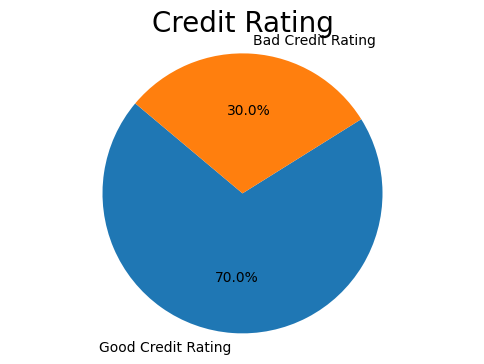

In [8]:
cr1 = (df[df.columns[-1]] == 1.0).sum()
cr0 = (df[df.columns[-1]] == 0.0).sum()

sizes = [cr1, cr0]
labels = ['Good Credit Rating', 'Bad Credit Rating']

plt.figure(figsize=(6, 4))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 10})
plt.title('Credit Rating', fontsize = 20)

plt.axis('equal')
plt.show()

The dataset is imbalanced, hence we will have to use SMOTE (Synthetic Minority Oversampling Technique) to ensure that the results from the model are not biased against the minoroty class.

### EXPLORATORY DATA ANALYSIS

In [9]:
fraction_train=0.7
fraction_test=0.3
df_train, df_test = train_test_split(df,train_size=fraction_train,test_size=fraction_test,random_state=42)

In [10]:
plt.figure(figsize=(200, 200))
sns. set_theme(font_scale=8)
sns.heatmap(df_train.corr(), annot=True, cmap='coolwarm', center=0.0, annot_kws={"fontsize":60}, fmt=".2f")
plt.title('Correlation Heatmap of Features')
plt.show()

In [10]:
df_train = df_train.drop(columns=['credit_amount_high', 'credit_duration_months_high', 'age_high', 'installment_rate(perc_disp_income)_high', 'residence_duration_high','telephone_yes',
                                  'occupation_skilled-employee__AND__guarantor_none','foreign_worker_yes__AND__previous_credit_payment_status_existing_credits_paid_till_now','foreign_worker_yes__AND__telephone_no',
                                  'guarantor_none__AND__telephone_no','savings_little__AND__foreign_worker_yes','foreign_worker_yes__AND__guarantor_none',
                                  'savings_little__AND__guarantor_none','occupation_skilled-employee__AND__foreign_worker_yes',
                                  'foreign_worker_yes__AND__installment_rate(perc_disp_income)_high','foreign_worker_yes__AND__credit_duration_months_high',
                                  'installment_rate(perc_disp_income)_high__AND__guarantor_none','guarantor_none__AND__credit_duration_months_high',
                                  'foreign_worker_yes__AND__residence_duration_high','residence_duration_high__AND__guarantor_none',
                                  'foreign_worker_yes__AND__other_credits_none','foreign_worker_yes__AND__apartment_type_own','residence_duration_high__AND__guarantor_none'
                                  ])
df_test = df_test.drop(columns=['credit_amount_high', 'credit_duration_months_high', 'age_high', 'installment_rate(perc_disp_income)_high', 'residence_duration_high','telephone_yes',
                                  'occupation_skilled-employee__AND__guarantor_none','foreign_worker_yes__AND__previous_credit_payment_status_existing_credits_paid_till_now','foreign_worker_yes__AND__telephone_no',
                                  'guarantor_none__AND__telephone_no','savings_little__AND__foreign_worker_yes','foreign_worker_yes__AND__guarantor_none',
                                  'savings_little__AND__guarantor_none','occupation_skilled-employee__AND__foreign_worker_yes',
                                  'foreign_worker_yes__AND__installment_rate(perc_disp_income)_high','foreign_worker_yes__AND__credit_duration_months_high',
                                  'installment_rate(perc_disp_income)_high__AND__guarantor_none','guarantor_none__AND__credit_duration_months_high',
                                  'foreign_worker_yes__AND__residence_duration_high','residence_duration_high__AND__guarantor_none',
                                  'foreign_worker_yes__AND__other_credits_none','foreign_worker_yes__AND__apartment_type_own','residence_duration_high__AND__guarantor_none'
                                   ])


#,'other_credits_none__AND__installment_rate(perc_disp_income)_high','occupation_skilled-employee__AND__other_credits_none','guarantor_none__AND__apartment_type_own','other_credits_none__AND__guarantor_none'

In [12]:
plt.figure(figsize=(200, 200))
sns. set_theme(font_scale=8)
sns.heatmap(df_train.corr(), annot=True, cmap='coolwarm', center=0.0, annot_kws={"fontsize":60}, fmt=".2f")
plt.title('Correlation Heatmap of Features')
plt.show()

In [11]:
x_train = df_train[df_train.columns[:-1]]
x_test = df_test[df_test.columns[:-1]]
y_train = df_train[df_train.columns[-1]]
y_test = df_test[df_test.columns[-1]]

In [12]:
sm = SMOTE(random_state=42)
x_res, y_res = sm.fit_resample(x_train, y_train)
print('Resampled training dataset shape %s' % Counter(y_res))
df_train = pd.concat([x_res, y_res], axis=1)


Resampled training dataset shape Counter({0: 501, 1: 501})


In [13]:
df_train, df_val = train_test_split(df_train, train_size=0.8, test_size=0.2, random_state=42)
x_train = df_train[df_train.columns[:-1]]
x_val = df_val[df_val.columns[:-1]]
y_val = df_val[df_val.columns[-1]]
y_train = df_train[df_train.columns[-1]]

## TRAINING THE BNN USING KERAS

In [14]:
# All quantized layers except the first will use the same options
kwargs = dict(input_quantizer="ste_sign",
              kernel_quantizer="ste_sign",
              kernel_constraint="weight_clip")

model = tf.keras.models.Sequential()

# In the first layer, quantize only the weights and not the input
model.add(lq.layers.QuantDense(4,
                                kernel_quantizer="ste_sign",
                                kernel_constraint="weight_clip",
                                use_bias=False,
                                input_shape=(x_train.shape[1],)))
model.add(tf.keras.layers.BatchNormalization())

model.add(lq.layers.QuantDense(
            4,
            input_quantizer="ste_sign",
            kernel_quantizer="ste_sign",
            kernel_constraint="weight_clip"))
model.add(tf.keras.layers.BatchNormalization())
#model.add(tf.keras.laactivation="hard_tanh"yers.Activation('hard_tanh'))


#model.add(lq.layers.QuantDense(4, use_bias=False, **kwargs))
#model.add(tf.keras.layers.BatchNormalization(scale=False))
model.add(lq.layers.QuantDense(1, activation='sigmoid'))
#model.add(tf.keras.layers.BatchNormalization(scale=False))
#model.add(tf.keras.layers.Activation("sigmoid"))



lq.models.summary(model)

+sequential stats---------------------------------------------------------------------------------+
| Layer                  Input prec.  Outputs  # 1-bit  # 32-bit  Memory  1-bit MACs  32-bit MACs |
|                              (bit)               x 1       x 1    (kB)                          |
+-------------------------------------------------------------------------------------------------+
| quant_dense                      -  (-1, 4)      108         0    0.01           0          108 |
| batch_normalization              -  (-1, 4)        0         8    0.03           0            0 |
| quant_dense_1                    1  (-1, 4)       16         4    0.02          16            0 |
| batch_normalization_1            -  (-1, 4)        0         8    0.03           0            0 |
| quant_dense_2                    -  (-1, 1)        0         5    0.02           0            4 |
+-------------------------------------------------------------------------------------------------+


In [15]:
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.fit(x_train, y_train, batch_size=64, epochs=100)

test_loss, test_acc = model.evaluate(x_test, y_test)
train_loss, train_acc = model.evaluate(x_train, y_train)

Epoch 1/100
13/13 [==============================] - 1s 2ms/step - loss: 0.7494 - accuracy: 0.4569
Epoch 2/100
13/13 [==============================] - 0s 2ms/step - loss: 0.7383 - accuracy: 0.4732
Epoch 3/100
13/13 [==============================] - 0s 2ms/step - loss: 0.7068 - accuracy: 0.5169
Epoch 4/100
13/13 [==============================] - 0s 2ms/step - loss: 0.7029 - accuracy: 0.5131
Epoch 5/100
13/13 [==============================] - 0s 2ms/step - loss: 0.6917 - accuracy: 0.5468
Epoch 6/100
13/13 [==============================] - 0s 2ms/step - loss: 0.6828 - accuracy: 0.5793
Epoch 7/100
13/13 [==============================] - 0s 2ms/step - loss: 0.6685 - accuracy: 0.5843
Epoch 8/100
13/13 [==============================] - 0s 2ms/step - loss: 0.6539 - accuracy: 0.6105
Epoch 9/100
13/13 [==============================] - 0s 2ms/step - loss: 0.6468 - accuracy: 0.6317
Epoch 10/100
13/13 [==============================] - 0s 2ms/step - loss: 0.6294 - accuracy: 0.6542
Epoch 11/

In [16]:
print("Training Loss: ",train_loss,"Training Accuracy", train_acc)
print("Test Loss: ",test_loss,"Test Accuracy", test_acc)

Training Loss:  0.5659785270690918 Training Accuracy 0.7315855026245117
Test Loss:  0.7328749895095825 Test Accuracy 0.6466666460037231


### HYPERPARAMETER TUNING AND EARLY STOPPING

In [17]:
from keras.callbacks import EarlyStopping

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)


#def reset_tf_session():
    #keras.backend.clear_session()
    #tf.compat.v1.reset_default_graph()
    #tf.keras.backend.clear_session()

def build_model(hp):
    #reset_tf_session()
    model = keras.models.Sequential()
    model.add(QuantDense(units=hp.Int('units_input', min_value=2, max_value=50, step=2),
                    input_shape=(x_train.shape[1],),kernel_quantizer="ste_sign",
                                kernel_constraint="weight_clip",
                                use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    
    num_layers = hp.Int('num_layers', min_value=0, max_value=10)
    model.layers.clear()
    for i in range(num_layers):
        model.add(QuantDense(units=hp.Int(f"units_{i+1}", min_value=2, max_value=50, step=2),**kwargs,use_bias=False))
        model.add(tf.keras.layers.BatchNormalization())
        #model.add(tf.keras.layers.Activation('hard_tanh'))

    
    model.add(QuantDense(1, activation='sigmoid'))  # Output layer for binary classification
    if hp.Boolean("dropout"):
        model.add(tf.keras.layers.Dropout(rate=0.25))
    
    # Compile the model
    model.compile(optimizer=keras.optimizers.Adam(hp.Float('learning_rate', min_value=1e-4, max_value=1e-1, sampling="log")),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Define the tuner
tuner = RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=10,  # Number of hyperparameter combinations to try
    executions_per_trial=3,  # Number of models to train per trial
    directory='my_dir',  # Directory to store the results
    project_name='my_project2',  # Name for the project
    overwrite=True  # Overwrite the results of the previous run
)

# Perform the hyperparameter search
tuner.search(x_train, y_train, epochs=50, validation_data=(x_val, y_val),callbacks=[early_stopping])

Trial 10 Complete [00h 00m 25s]
val_accuracy: 0.762852410475413

Best val_accuracy So Far: 0.7893863916397095
Total elapsed time: 00h 03m 07s


In [18]:
best_model = tuner.get_best_models(num_models=1)[0]


train_loss, train_acc = best_model.evaluate(x_train, y_train)
test_loss, test_acc = best_model.evaluate(x_test, y_test)
print(f"Train Loss: {train_loss}, Train Accuracy: {train_acc}")
print(f"Test Loss: {test_loss}, Test Accuracy: {test_acc}")

10/10 [==============================] - 0s 1ms/step - loss: 0.6205 - accuracy: 0.6600
Train Loss: 0.49019870162010193, Train Accuracy: 0.7765293121337891
Test Loss: 0.6205071806907654, Test Accuracy: 0.6600000262260437


In [19]:
tuner.results_summary()

Results summary
Results in my_dir/my_project2
Showing 10 best trials
Objective(name="val_accuracy", direction="max")

Trial 00 summary
Hyperparameters:
units_input: 48
num_layers: 1
dropout: True
learning_rate: 0.009376559432095958
units_1: 2
Score: 0.7893863916397095

Trial 02 summary
Hyperparameters:
units_input: 24
num_layers: 2
dropout: True
learning_rate: 0.03211316174781063
units_1: 10
units_2: 8
units_3: 16
units_4: 8
units_5: 44
units_6: 40
units_7: 30
units_8: 8
units_9: 26
units_10: 26
Score: 0.7661691506703695

Trial 09 summary
Hyperparameters:
units_input: 36
num_layers: 9
dropout: True
learning_rate: 0.01533727764831254
units_1: 26
units_2: 26
units_3: 42
units_4: 6
units_5: 44
units_6: 2
units_7: 48
units_8: 46
units_9: 10
units_10: 42
Score: 0.762852410475413

Trial 03 summary
Hyperparameters:
units_input: 46
num_layers: 7
dropout: False
learning_rate: 0.00019474006896852013
units_1: 30
units_2: 48
units_3: 12
units_4: 22
units_5: 46
units_6: 28
units_7: 14
units_8: 18
u

In [20]:
best_hp = tuner.get_best_hyperparameters()[0]
best_hp_vals = best_hp.values
for i in range(1,11):
    if i>best_hp_vals['num_layers']:
        del best_hp_vals[f'units_{i}']
best_hp_vals

KeyError: 'units_2'

We can also extract the weights of the connections and the neuron activations for a particular input from the trained best model.

In [21]:
best_hp_vals

{'units_input': 48,
 'num_layers': 1,
 'dropout': True,
 'learning_rate': 0.009376559432095958,
 'units_1': 2}

In [22]:
weights_keras = []
for i in range(0,2*(best_hp_vals['num_layers']+1)+1,2):
    weights_keras.append(best_model.layers[i].get_weights()[0])

In [23]:
weights_keras #can be used to initialize the CPO model solution later on

[array([[ 0.18189567,  0.25629675,  0.00675057, ..., -0.23003784,
          0.3967158 , -0.0645338 ],
        [ 0.01940004,  0.30697265, -0.0354874 , ..., -0.39412785,
          0.03304151,  0.4622642 ],
        [ 0.3351508 ,  0.3779309 ,  0.38601923, ..., -0.25948092,
         -0.31424052,  0.271625  ],
        ...,
        [ 0.14129627,  0.21035929,  0.04065971, ..., -0.3042026 ,
         -0.32056674,  0.059841  ],
        [-0.01775299, -0.01865597,  0.03922551, ..., -0.05864287,
          0.00253431,  0.33885852],
        [-0.13667883, -0.21752882, -0.30348969, ..., -0.04133403,
         -0.02441431,  0.46597832]], dtype=float32),
 array([[ 0.04738313, -0.3293815 ],
        [-0.19029243, -0.15079439],
        [-0.02665114,  0.5623087 ],
        [-0.47281823, -0.45476273],
        [ 0.11798291, -0.03968713],
        [ 0.13750966,  0.1979474 ],
        [ 0.1161254 ,  0.5253578 ],
        [ 0.26111758,  0.17137623],
        [ 0.11544446,  0.25714126],
        [-0.2836497 , -0.10657994]

In [24]:
bin_weights_keras = []
for i in range(0,2*(best_hp_vals['num_layers']+1)+1,2):
    with lq.context.quantized_scope(True):
        bin_weights_keras.append(best_model.layers[i].get_weights()[0])

In [25]:
bin_weights_keras

[array([[ 1.,  1.,  1., ..., -1.,  1., -1.],
        [ 1.,  1., -1., ..., -1.,  1.,  1.],
        [ 1.,  1.,  1., ..., -1., -1.,  1.],
        ...,
        [ 1.,  1.,  1., ..., -1., -1.,  1.],
        [-1., -1.,  1., ..., -1.,  1.,  1.],
        [-1., -1., -1., ..., -1., -1.,  1.]], dtype=float32),
 array([[ 1., -1.],
        [-1., -1.],
        [-1.,  1.],
        [-1., -1.],
        [ 1., -1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [-1., -1.],
        [ 1.,  1.],
        [-1.,  1.],
        [-1., -1.],
        [ 1., -1.],
        [-1., -1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [-1., -1.],
        [ 1.,  1.],
        [-1., -1.],
        [-1., -1.],
        [-1.,  1.],
        [ 1.,  1.],
        [ 1., -1.],
        [-1., -1.],
        [-1., -1.],
        [-1., -1.],
        [-1., -1.],
        [ 1.,  1.],
        [ 1.,  1.],
        [-1., -1.],


In [52]:
from keras import Model
# Extract the Model Outputs for all the Layers
Model_Outputs = [layer.output for layer in best_model.layers]
# Create a Model with Model Input as Input and the Model Outputs as Output
Activation_Model = Model(best_model.input, Model_Outputs)
with lq.context.quantized_scope(True):
    Activations = Activation_Model.predict(x_train)

26/26 [==============================] - 0s 1ms/step


In [53]:
Activations

[array([[  7., -11.,  -1., ...,  -3.,   1.,   1.],
        [ -9.,  -3.,  -5., ...,   1.,   1.,   1.],
        [ -3.,  -5.,  -3., ...,   3.,   3.,   7.],
        ...,
        [  3.,  -7.,  -5., ...,  17.,   5.,  -3.],
        [  9.,   3.,  -3., ...,   3.,  -5., -13.],
        [ -5.,  -3.,  -9., ...,   1.,  -3.,  -7.]], dtype=float32),
 array([[ 1.1966919e+00, -6.4260950e+00,  1.8868834e-02, ...,
          1.5840702e+00,  3.4098434e-01, -8.8196993e-04],
        [-2.7079229e+00, -1.9085280e+00, -8.3707201e-01, ...,
          3.3972132e+00,  3.4098434e-01, -8.8196993e-04],
        [-1.2436924e+00, -3.0379198e+00, -4.0910158e-01, ...,
          4.3037848e+00,  9.0540445e-01,  2.5723193e+00],
        ...,
        [ 2.2053814e-01, -4.1673117e+00, -8.3707201e-01, ...,
          1.0649786e+01,  1.4698247e+00, -1.7163494e+00],
        [ 1.6847687e+00,  1.4796475e+00, -4.0910158e-01, ...,
          4.3037848e+00, -1.3522762e+00, -6.0050182e+00],
        [-1.7317693e+00, -1.9085280e+00, -1.6930128

In [45]:
extractor = best_model(inputs=best_model.inputs,
                        outputs=[layer.output for layer in best_model.layers])
features = extractor(data)

TypeError: call() got an unexpected keyword argument 'outputs'

## CPO Model

In [26]:
from docplex.cp.model import *
context.solver.agent = 'local'
#context.solver.local.execfile = 'Path to the binary cpoptimizer'
context.solver.local.execfile = '/net/phorcys/data/roc/Logiciels/CPLEX_Studio201/cpoptimizer/bin/x86-64_linux/cpoptimizer'
#context.params.set_attribute('Presolve', 'Off')
context.params.set_attribute('Workers', 1)

In [27]:
y_train = y_train.replace(to_replace=0,value=-1)

### SIMPLICITY OBJECTIVE: Minimizing the absolute sum of weights

In [28]:
x_train = x_train.replace(to_replace=0,value=-1)

In [29]:

N = [x_train.shape[1], 6, 6, 36, 18, 1]  # Number of features in the input layer
L = len(N) - 1  # index of last layer in the network
assert all(N[l]>1 for l in range(L))


min_weight_mdl = CpoModel(name='German Credit CP Model Min Weight')

weights = []
activations = []

# activations for the input layer
activations_0 = [[min_weight_mdl.integer_var(-1,1, name=f"n_0_{j}_{k}") for j in range(N[0])] for k in range(df_train.shape[0])]

for k in range(df_train.shape[0]):
    for j in range(N[0]):
        min_weight_mdl.add(activations_0[k][j] == x_train.iloc[k][j])


activations.append(activations_0)

#activations and weights for hidden layers and output layer
for l in range(1, L+1):
    activations_l = [[min_weight_mdl.integer_var(domain=(-1,1), name=f"n_{l}_{j}_{k}") for j in range(1, N[l] + 1)] for k in range(1, df_train.shape[0] + 1)]
    

    weights_l = [[min_weight_mdl.integer_var(domain=(-1,0,1), name=f"w_{i}_{l}_{j}") for i in range(1, N[l - 1] + 1)] for j in range(1, N[l] + 1)]
    

    for k in range(df_train.shape[0]):
        if l==L:
            if N[l]==1:
                min_weight_mdl.add(activations_l[k][0] == y_train.iloc[k])
            else:
                for j in range(N[l]):
                    min_weight_mdl.add(activations_l[k][j] == y_train.iloc[k][j])
        else:
            for j in range(N[l]):
                dot_product_expr = min_weight_mdl.integer_var(0, 10000,name=f'dot_prod_{l}_{j}_{k}')
                min_weight_mdl.add(dot_product_expr == min_weight_mdl.scal_prod(weights_l[j], activations[l-1][k]))
                #activation_state = min_weight_mdl.integer_var(0, 1, name=f"activation_{l}_{j}_{k}")

                min_weight_mdl.add((dot_product_expr >= 0) & (activations_l[k][j] == 1) | (dot_product_expr < 0) & (activations_l[k][j] == -1))
                #min_weight_mdl.if_then(dot_product_expr>=0,activation_state==1)
                #min_weight_mdl.if_then(dot_product_expr<0,activation_state==0)
                min_weight_mdl.add(activations_l[k][j] == 2 * activation_state - 1)
     

    activations.append(activations_l)
    weights.append(weights_l)


activation_vars = [var for layer in activations for sample in layer for var in sample]
weights_vars = [prev_neuron for layer in weights for neuron in layer for prev_neuron in neuron]
abs_weights_vars = [min_weight_mdl.abs(prev_neuron) for layer in weights for neuron in layer for prev_neuron in neuron]

# Define the objective
min_weight_obj = min_weight_mdl.integer_var(0, 10000, name='min_weight_objective')
min_weight_mdl.add(min_weight_obj == min_weight_mdl.sum(abs_weights_vars))
min_weight_mdl.add(min_weight_mdl.minimize(min_weight_obj))



SearchPhase = min_weight_mdl.search_phase(weights_vars,varchooser = min_weight_mdl.select_smallest(min_weight_mdl.var_index(weights_vars)),valuechooser=min_weight_mdl.select_smallest(min_weight_mdl.value_impact()))
min_weight_mdl.add_search_phase(SearchPhase)

# Solve the model
min_weight_solution = min_weight_mdl.solve(SearchType='Restart')

 ! --------------------------------------------------- CP Optimizer 20.1.0.0 --
 ! Minimization problem - 129241 variables, 128161 constraints, 1 phase
 ! Workers              = 1
 ! SearchType           = Restart
 ! Initial process time : 3.00s (2.99s extraction + 0.02s propagation)
 !  . Log search space  : 191640.7 (before), 191640.7 (after)
 !  . Memory usage      : 171.9 MB (before), 171.9 MB (after)
 ! Using sequential search.
 ! ----------------------------------------------------------------------------
 !          Best Branches  Non-fixed            Branch decision
                        0     129241                 -
 + New bound is 0
 *             0        0  3.40s               (gap is 0.00%)
 ! ----------------------------------------------------------------------------
 ! Search completed, 1 solution found.
 ! Best objective         : 0 (optimal - effective tol. is 0)
 ! Best bound             : 0
 ! ----------------------------------------------------------------------

In [30]:
min_weight_solution.write()

-------------------------------------------------------------------------------
Model constraints: 128161, variables: integer: 129241, interval: 0, sequence: 0
Solve status: Optimal
Search status: SearchCompleted, stop cause: SearchHasNotBeenStopped
Solve time: 3.43 sec
-------------------------------------------------------------------------------
Objective values: (0,), bounds: (0,), gaps: (0,)
Variables:
   dot_prod_1_0_0 = 0
   dot_prod_1_0_1 = 0
   dot_prod_1_0_2 = 0
   dot_prod_1_0_3 = 0
   dot_prod_1_0_4 = 0
   dot_prod_1_0_5 = 0
   dot_prod_1_0_6 = 0
   dot_prod_1_0_7 = 0
   dot_prod_1_0_8 = 0
   dot_prod_1_0_9 = 0
   dot_prod_1_0_10 = 0
   dot_prod_1_0_11 = 0
   dot_prod_1_0_12 = 0
   dot_prod_1_0_13 = 0
   dot_prod_1_0_14 = 0
   dot_prod_1_0_15 = 0
   dot_prod_1_0_16 = 0
   dot_prod_1_0_17 = 0
   dot_prod_1_0_18 = 0
   dot_prod_1_0_19 = 0
   dot_prod_1_0_20 = 0
   dot_prod_1_0_21 = 0
   dot_prod_1_0_22 = 0
   dot_prod_1_0_23 = 0
   dot_prod_1_0_24 = 0
   dot_prod_1_0_25 = 0
 

In [35]:
N = [x_train.shape[1], best_hp_vals['units_input']]  # Number of features in the input layer
for i in range(1,best_hp_vals['num_layers']+1):
    N.append(best_hp_vals[f'units_{i}'])
N.append(1)
print(N)
L = len(N) - 1  # index of last layer in the network
assert all(N[l]>1 for l in range(L))


min_weight_mdl = CpoModel(name='German Credit CP Model Min Weight')

weights = []
activations = []

# activations for the input layer
activations_0 = [[min_weight_mdl.integer_var(domain=(-1,1), name=f"n_0_{j}_{k}") for j in range(N[0])] for k in range(df_train.shape[0])]

for k in range(df_train.shape[0]):
    for j in range(N[0]):
        min_weight_mdl.add(activations_0[k][j] == x_train.iloc[k][j])


activations.append(activations_0)

#activations and weights for hidden layers and output layer
for l in range(1, L+1):
    activations_l = [[min_weight_mdl.integer_var(domain=(-1,1), name=f"n_{l}_{j}_{k}") for j in range(1, N[l] + 1)] for k in range(1, df_train.shape[0] + 1)]
    

    weights_l = [[min_weight_mdl.integer_var(domain=(-1,1), name=f"w_{i}_{l}_{j}") for i in range(1, N[l - 1] + 1)] for j in range(1, N[l] + 1)]
    

    
    if l==L:
        corr_pred = [min_weight_mdl.integer_var(0,1,name=f'corr_pred_{k}') for k in range(df_train.shape[0])]
        for k in range(df_train.shape[0]):    
            if N[l]==1:
                min_weight_mdl.add(min_weight_mdl.if_then(activations_l[k][0]==y_train.iloc[k],corr_pred[k]==1))
                min_weight_mdl.add(min_weight_mdl.if_then(activations_l[k][0]!=y_train.iloc[k],corr_pred[k]==0))
            else:
                correct_prediction_condition = min_weight_mdl.logical_and([activations_l[k][j] == y_train.iloc[k][j] for j in range(N[l])])

                min_weight_mdl.add(min_weight_mdl.if_then(correct_prediction_condition, corr_pred[k] == 1))
                min_weight_mdl.add(min_weight_mdl.if_then(min_weight_mdl.logical_not(correct_prediction_condition), corr_pred[k] == 0))
        min_weight_mdl.add(min_weight_mdl.sum(corr_pred)>0.75*df_train.shape[0])
            
            
    else:
        for k in range(df_train.shape[0]):
            for j in range(N[l]):
                dot_product_expr = min_weight_mdl.integer_var(0, 10000,name=f'dot_prod_{l}_{j}_{k}')
                min_weight_mdl.add(dot_product_expr == min_weight_mdl.scal_prod(weights_l[j], activations[l-1][k]))
                #activation_state = min_weight_mdl.integer_var(0, 1, name=f"activation_{l}_{j}_{k}")

                min_weight_mdl.add((dot_product_expr >= 0) & (activations_l[k][j] == 1) | (dot_product_expr < 0) & (activations_l[k][j] == -1))
                #min_weight_mdl.if_then(dot_product_expr>=0,activation_state==1)
                #min_weight_mdl.if_then(dot_product_expr<0,activation_state==0)
                min_weight_mdl.add(activations_l[k][j] == 2 * activation_state - 1)
     

    activations.append(activations_l)
    weights.append(weights_l)




activation_vars = [var for layer in activations for sample in layer for var in sample]
weights_vars = [prev_neuron for layer in weights for neuron in layer for prev_neuron in neuron]
abs_weights_vars = [min_weight_mdl.abs(prev_neuron) for layer in weights for neuron in layer for prev_neuron in neuron]

# Define the objective
min_weight_obj = min_weight_mdl.integer_var(0, 10000, name='min_weight_objective')
min_weight_mdl.add(min_weight_obj == min_weight_mdl.sum(abs_weights_vars))
min_weight_mdl.add(min_weight_mdl.minimize(min_weight_obj))



#SearchPhase = min_weight_mdl.search_phase(weights_vars,varchooser = min_weight_mdl.select_smallest(min_weight_mdl.var_index(weights_vars)),valuechooser=min_weight_mdl.select_smallest(min_weight_mdl.value_impact()))
#min_weight_mdl.add_search_phase(SearchPhase)

# Solve the model
min_weight_solution = min_weight_mdl.solve(SearchType='Restart')

[27, 48, 2, 1]
 ! --------------------------------------------------- CP Optimizer 20.1.0.0 --
 ! Minimization problem - 105525 variables, 104933 constraints
 ! Workers              = 1
 ! SearchType           = Restart
 ! Initial process time : 1.45s (1.45s extraction + 0.01s propagation)
 !  . Log search space  : 586697.0 (before), 586697.0 (after)
 !  . Memory usage      : 226.9 MB (before), 226.9 MB (after)
 ! Using sequential search.
 ! ----------------------------------------------------------------------------
 !          Best Branches  Non-fixed            Branch decision
                        0     105525                 -
 + New bound is 0
 ! ----------------------------------------------------------------------------
 ! Search completed, model has no solution.
 ! Best bound             : 0
 ! ----------------------------------------------------------------------------
 ! Number of branches     : 0
 ! Number of fails        : 1
 ! Total memory usage     : 456.5 MB (437.3 MB

### LAST VERSION

In [54]:
N = [x_train.shape[1], best_hp_vals['units_input']]  # Number of features in the input layer
for i in range(1,best_hp_vals['num_layers']+1):
    N.append(best_hp_vals[f'units_{i}'])
N.append(1)
print(N)
L = len(N) - 1  # index of last layer in the network
assert all(N[l]>1 for l in range(L))


min_weight_mdl = CpoModel(name='German Credit CP Model Min Weight')

weights = []
activations = []

# activations for the input layer
activations_0 = [[min_weight_mdl.integer_var(domain=(-1,1), name=f"n_0_{j}_{k}") for j in range(N[0])] for k in range(df_train.shape[0])]

for k in range(df_train.shape[0]):
    for j in range(N[0]):
        min_weight_mdl.add(activations_0[k][j] == x_train.iloc[k][j])


activations.append(activations_0)

#activations and weights for hidden layers and output layer
for l in range(1, L+1):
    activations_l = [[min_weight_mdl.integer_var(domain=(-1,1), name=f"n_{l}_{j}_{k}") for j in range(1, N[l] + 1)] for k in range(1, df_train.shape[0] + 1)]
    

    weights_l = [[min_weight_mdl.integer_var(domain=(-1,1), name=f"w_{i}_{l}_{j}") for i in range(1, N[l - 1] + 1)] for j in range(1, N[l] + 1)]
    

    
    if l==L:
        corr_pred = [min_weight_mdl.integer_var(0,1,name=f'corr_pred_{k}') for k in range(df_train.shape[0])]
        for k in range(df_train.shape[0]):    
            if N[l]==1:
                min_weight_mdl.add(min_weight_mdl.if_then(activations_l[k][0]==y_train.iloc[k],corr_pred[k]==1))
                min_weight_mdl.add(min_weight_mdl.if_then(activations_l[k][0]!=y_train.iloc[k],corr_pred[k]==0))
            else:
                correct_prediction_condition = min_weight_mdl.logical_and([activations_l[k][j] == y_train.iloc[k][j] for j in range(N[l])])

                min_weight_mdl.add(min_weight_mdl.if_then(correct_prediction_condition, corr_pred[k] == 1))
                min_weight_mdl.add(min_weight_mdl.if_then(min_weight_mdl.logical_not(correct_prediction_condition), corr_pred[k] == 0))
        min_weight_mdl.add(min_weight_mdl.sum(corr_pred)>0.75*df_train.shape[0])
            
            
    
    for k in range(df_train.shape[0]):
        for j in range(N[l]):
            dot_product_expr = min_weight_mdl.integer_var(0, 10000,name=f'dot_prod_{l}_{j}_{k}')
            min_weight_mdl.add(dot_product_expr == min_weight_mdl.scal_prod(weights_l[j], activations[l-1][k]))
                #activation_state = min_weight_mdl.integer_var(0, 1, name=f"activation_{l}_{j}_{k}")

            min_weight_mdl.add((dot_product_expr >= 0) & (activations_l[k][j] == 1) | (dot_product_expr < 0) & (activations_l[k][j] == -1))
                #min_weight_mdl.if_then(dot_product_expr>=0,activation_state==1)
                #min_weight_mdl.if_then(dot_product_expr<0,activation_state==0)
                #min_weight_mdl.add(activations_l[k][j] == 2 * activation_state - 1)
     

    activations.append(activations_l)
    weights.append(weights_l)




activation_vars = [var for layer in activations for sample in layer for var in sample]
weights_vars = [prev_neuron for layer in weights for neuron in layer for prev_neuron in neuron]
abs_weights_vars = [min_weight_mdl.abs(prev_neuron) for layer in weights for neuron in layer for prev_neuron in neuron]

# Define the objective
min_weight_obj = min_weight_mdl.integer_var(0, 10000, name='min_weight_objective')
min_weight_mdl.add(min_weight_obj == min_weight_mdl.sum(abs_weights_vars))
min_weight_mdl.add(min_weight_mdl.minimize(min_weight_obj))



#SearchPhase = min_weight_mdl.search_phase(weights_vars,varchooser = min_weight_mdl.select_smallest(min_weight_mdl.var_index(weights_vars)),valuechooser=min_weight_mdl.select_smallest(min_weight_mdl.value_impact()))
#min_weight_mdl.add_search_phase(SearchPhase)

# Solve the model
min_weight_solution = min_weight_mdl.solve(SearchType='Restart')

[27, 48, 2, 1]
 ! --------------------------------------------------- CP Optimizer 20.1.0.0 --
 ! Minimization problem - 105525 variables, 104933 constraints
 ! Workers              = 1
 ! SearchType           = Restart
 ! Initial process time : 1.40s (1.38s extraction + 0.02s propagation)
 !  . Log search space  : 585881.5 (before), 585881.5 (after)
 !  . Memory usage      : 227.2 MB (before), 227.2 MB (after)
 ! Using sequential search.
 ! ----------------------------------------------------------------------------
 !          Best Branches  Non-fixed            Branch decision
                        0     105525                 -
 + New bound is 0
 ! ----------------------------------------------------------------------------
 ! Search completed, model has no solution.
 ! Best bound             : 0
 ! ----------------------------------------------------------------------------
 ! Number of branches     : 0
 ! Number of fails        : 1
 ! Total memory usage     : 457.1 MB (437.7 MB

In [40]:
min_weight_solution.write()

-------------------------------------------------------------------------------
Model constraints: 104933, variables: integer: 105525, interval: 0, sequence: 0
Solve status: Optimal
Search status: SearchCompleted, stop cause: SearchHasNotBeenStopped
Solve time: 3.08 sec
-------------------------------------------------------------------------------
Objective values: (0,), bounds: (0,), gaps: (0,)
Variables:
   corr_pred_0 = 1
   corr_pred_1 = 1
   corr_pred_2 = 1
   corr_pred_3 = 1
   corr_pred_4 = 1
   corr_pred_5 = 1
   corr_pred_6 = 0
   corr_pred_7 = 0
   corr_pred_8 = 0
   corr_pred_9 = 1
   corr_pred_10 = 1
   corr_pred_11 = 0
   corr_pred_12 = 0
   corr_pred_13 = 1
   corr_pred_14 = 1
   corr_pred_15 = 0
   corr_pred_16 = 1
   corr_pred_17 = 0
   corr_pred_18 = 0
   corr_pred_19 = 0
   corr_pred_20 = 0
   corr_pred_21 = 0
   corr_pred_22 = 0
   corr_pred_23 = 0
   corr_pred_24 = 1
   corr_pred_25 = 1
   corr_pred_26 = 0
   corr_pred_27 = 0
   corr_pred_28 = 1
   corr_pred_29 = 1

In [ ]:
min_weight_solution.get_value('n_2_1_1')

1

### ROBUSTNESS MODEL: Maximizing the sum of margins 

In [ ]:

N = [x_train.shape[1], best_hp_vals['units_input']]  # Number of features in the input layer
for i in range(1,best_hp_vals['num_layers']+1):
    N.append(best_hp_vals[f'units_{i}'])
N.append(1)
L = len(N) - 1  # index of last layer in the network
assert all(N[l]>1 for l in range(L))


max_margin_mdl = CpoModel(name='German Credit CP Model Max Margin')

weights = []
activations = []

# activations for the input layer
activations_0 = [[max_margin_mdl.integer_var(-1,1, name=f"n_0_{j}_{k}") for j in range(N[0])] for k in range(df_train.shape[0])]

for k in range(df_train.shape[0]):
    for j in range(N[0]):
        max_margin_mdl.add(activations_0[k][j] == x_train.iloc[k][j])


activations.append(activations_0)

#activations and weights for hidden layers and output layer
for l in range(1, L+1):
    activations_l = [[max_margin_mdl.integer_var(domain=(-1,1), name=f"n_{l}_{j}_{k}") for j in range(1, N[l] + 1)] for k in range(1, df_train.shape[0] + 1)]
    

    weights_l = [[max_margin_mdl.integer_var(domain=(-1,0,1), name=f"w_{i}_{l}_{j}") for i in range(1, N[l - 1] + 1)] for j in range(1, N[l] + 1)]
    

    if l==L:
        corr_pred = [max_margin_mdl.integer_var(0,1,name=f'corr_pred_{k}') for k in range(df_train.shape[0])]
        for k in range(df_train.shape[0]):    
            if N[l]==1:
                max_margin_mdl.add(max_margin_mdl.if_then(activations_l[k][0]==y_train.iloc[k],corr_pred[k]==1))
                max_margin_mdl.add(max_margin_mdl.if_then(activations_l[k][0]!=y_train.iloc[k],corr_pred[k]==0))
            else:
                correct_prediction_condition = max_margin_mdl.logical_and([activations_l[k][j] == y_train.iloc[k][j] for j in range(N[l])])

                max_margin_mdl.add(max_margin_mdl.if_then(correct_prediction_condition, corr_pred[k] == 1))
                max_margin_mdl.add(max_margin_mdl.if_then(max_margin_mdl.logical_not(correct_prediction_condition), corr_pred[k] == 0))
        max_margin_mdl.add(max_margin_mdl.sum(corr_pred)>0.75*df_train.shape[0])
            
            
    else:
        for k in range(df_train.shape[0]):
            for j in range(N[l]):
                dot_product_expr = max_margin_mdl.integer_var(0, 10000,name=f'dot_prod_{l}_{j}_{k}')
                max_margin_mdl.add(dot_product_expr == max_margin_mdl.scal_prod(weights_l[j], activations[l-1][k]))
                activation_state = max_margin_mdl.integer_var(0, 1, name=f"activation_{l}_{j}_{k}")

                max_margin_mdl.add((dot_product_expr >= 0) & (activation_state == 1) | (dot_product_expr < 0) & (activation_state == 0))
                #max_margin_mdl.if_then(dot_product_expr>=0,activation_state==1)
                #max_margin_mdl.if_then(dot_product_expr<0,activation_state==0)
                max_margin_mdl.add(activations_l[k][j] == 2 * activation_state - 1)
     

    activations.append(activations_l)
    weights.append(weights_l)


activation_vars = [var for layer in activations for sample in layer for var in sample]
weights_vars = [prev_neuron for layer in weights for neuron in layer for prev_neuron in neuron]
abs_weights_vars = [max_margin_mdl.abs(prev_neuron) for layer in weights for neuron in layer for prev_neuron in neuron]

# Define the objective
max_margin_obj = max_margin_mdl.integer_var(0, 10000, name='min_weight_objective')
activations_layer1 = np.array(activations[1]).T.tolist()
margins_neurons = []
for l in activations_layer1:
    lst=[]
    for elem in l:
        lst.append(max_margin_mdl.abs(elem))
    margins_neurons.append(max_margin_mdl.min(lst))

max_margin_mdl.add(max_margin_obj == max_margin_mdl.sum(margins_neurons))
max_margin_mdl.add(max_margin_mdl.maximize(max_margin_obj))



SearchPhase = max_margin_mdl.search_phase(activation_vars,varchooser = max_margin_mdl.select_smallest(max_margin_mdl.var_index(activation_vars)),valuechooser=max_margin_mdl.select_smallest(max_margin_mdl.value_impact()))
max_margin_mdl.add_search_phase(SearchPhase)

# Solve the model
max_margin_solution = max_margin_mdl.solve(SearchType='Restart')

 ! --------------------------------------------------- CP Optimizer 20.1.0.0 --
 ! Maximization problem - 335050 variables, 330815 constraints, 1 phase
 ! Presolve      : 1 extractable eliminated
 ! Workers              = 1
 ! SearchType           = Restart
 ! Initial process time : 9.20s (9.16s extraction + 0.04s propagation)
 !  . Log search space  : 497837.9 (before), 497837.9 (after)
 !  . Memory usage      : 550.5 MB (before), 550.5 MB (after)
 ! Using sequential search.
 ! ----------------------------------------------------------------------------
 !          Best Branches  Non-fixed            Branch decision
                        0     335050                 -
 + New bound is 20
                     1000      98508             -1  = w_21_3_31
                     2000      78333             -1  = w_23_3_21
 *            20     2665  31.72s              (gap is 0.00%)
 ! ----------------------------------------------------------------------------
 ! Search completed, 1 soluti

In [ ]:
max_margin_solution.print_solution()

-------------------------------------------------------------------------------
Model constraints: 330815, variables: integer: 335050, interval: 0, sequence: 0
Solve status: Optimal
Search status: SearchCompleted, stop cause: SearchHasNotBeenStopped
Solve time: 31.85 sec
-------------------------------------------------------------------------------
Objective values: (20,), bounds: (20,), gaps: (0,)
Variables:
   activation_1_0_0 = 1
   activation_1_0_1 = 1
   activation_1_0_2 = 1
   activation_1_0_3 = 1
   activation_1_0_4 = 1
   activation_1_0_5 = 1
   activation_1_0_6 = 1
   activation_1_0_7 = 1
   activation_1_0_8 = 1
   activation_1_0_9 = 1
   activation_1_0_10 = 1
   activation_1_0_11 = 1
   activation_1_0_12 = 1
   activation_1_0_13 = 1
   activation_1_0_14 = 1
   activation_1_0_15 = 1
   activation_1_0_16 = 1
   activation_1_0_17 = 1
   activation_1_0_18 = 1
   activation_1_0_19 = 1
   activation_1_0_20 = 1
   activation_1_0_21 = 1
   activation_1_0_22 = 1
   activation_1_0_23 

In [ ]:
max_margin_solution.get_value('n_2_1_1')

1

### Computing Test Accuracy of the Model Obtained using CPO

In [ ]:
def extract_weights_and_activations(solution, weights, activations):
    weights_values = []
    activations_values = []
    
    for layer_weights in weights:
        layer_weights_values = [[solution[w] for w in neuron_weights] for neuron_weights in layer_weights]
        weights_values.append(layer_weights_values)
        
    for layer_activations in activations:
        layer_activations_values = [[solution[a] for a in sample_activations] for sample_activations in layer_activations]
        activations_values.append(layer_activations_values)
        
    return weights_values, activations_values

# Function to perform forward pass
def forward_pass(weights, x):
    activations = [x]
    for layer_weights in weights[:-1]:
        x = np.sign(np.dot(x, np.array(layer_weights).T))
        activations.append(x)
    # Last layer output (no sign function)
def calculate_accuracy(weights, x_test, y_test):
    predictions, _ = forward_pass(weights, x_test)
    correct_predictions = np.sum(predictions.flatten() == y_test)
    accuracy = correct_predictions / len(y_test)
    return accuracy

#weights_values, activations_values = extract_weights_and_activations(min_weight_solution, weights, activations)


x_test = x_test.values 
y_test = y_test.values.flatten()  
weights, acts = extract_weights_and_activations(min_weight_solution,weights,activations)

test_accuracy = calculate_accuracy(weights, x_test, y_test)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

KeyError: "Variable or KPI 'w_1_1_1 = intVar(-1..1)' not in the solution"

In [ ]:
def forward_pass(weights, x):
    activations = [x]
    for l in range(1,L):
        activatons_l = []
        for j in range(N[l]):
            activation_j = np.sign(np.dot((np.array([weights[l-1][j]])),np.array(activations[l-1])))
            activations_l.append(activation_j)
        activations.append(activations_l)
    output = np.dot(np.array(weights[L]),np.array(activations[L-1]))
    return np.sign(output), activation_vars

weights
print((np.array(weights[0][0]).T).shape)
predictions, act = forward_pass(weights,x_test[0])
print(predictions)


(27,)


CpoException: CPO expression can not be used as boolean.

### Selecting Subset of Training Data far from each other

convert x_train into numpy array, each sample into a numpy vector
measure hamming distance and choose examples which differ in more than 1 bit (choose distance metric: https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.distance.dice.html )